## Análisis del Dataset Spotify_Youtube
El presente dataset contiene las estadísticas de las 10 mejores canciones de varios artistas en la plataforma de Spotify y su video en Youtube

#### Funciones que se usarán

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px

Funciones de imputación

In [2]:
from sklearn.linear_model import LinearRegression

# Imputación por Regresión Lineal
def ImputacionRegresionLineal(dataframe, columna_dependiente, columna_independiente):
    # Crear un dataframe con valores y otro sin valores
    df_con_valores = dataframe.dropna(subset=[columna_dependiente, columna_independiente])
    df_sin_valores = dataframe.loc[dataframe[columna_dependiente].isna(), :]
    
    # Modelo de Regresión
    modelo = LinearRegression()
    modelo.fit(df_con_valores[[columna_independiente]], df_con_valores[[columna_dependiente]])
    # Realizar predicción
    prediccion = modelo.predict(df_sin_valores[[columna_independiente]])
    # Asignar la predicción
    dataframe.loc[dataframe[columna_dependiente].isna(), columna_dependiente] = prediccion
    
    return dataframe

# Imputación por media
def ImputacionMedia(dataframe, columna):
    media = dataframe[columna].mean()
    dataframe[columna].fillna(media, inplace=True)
    return dataframe

# Imputación media por clase
def ImputacionMediaporClase(dataframe, columna, columna_clase):
    media_clase = dataframe.groupby(columna_clase)[columna].transform('mean') # Se retorna la media para cada instancia según su clase
    dataframe[columna].fillna(media_clase, inplace=True) # Se reemplazan los NA's con el valor calculado para cada instancia,
                                                            # esto sólo si esta vacía
    return dataframe

# Imputación por moda
def ImputacionModa(dataframe, columna):
    moda = dataframe[columna].mode()[0] # Se calcula la moda, si son varias se toma la primera
    dataframe[columna].fillna(moda, inplace=True)
    return dataframe

# Imputación Aleatoria
def ImputacionAleatoria(dataframe, columna):
    valores = dataframe[columna].dropna().values
    rango = valores.max() - valores.min()
    
    # Reemplazar valores faltantes
    instancias_faltantes = dataframe[columna].isnull()
    total_faltantes = instancias_faltantes.sum()
    imputacion = np.random.uniform(low=valores.min(), high=valores.max(), size=total_faltantes)
    dataframe.loc[instancias_faltantes, columna] = imputacion
    
    return dataframe

Funciones de Normalización

In [3]:
# Normalización min-max
def min_max_normalizacion(df, column, min_value=0, max_value=1):
    # Obtiene los valores mínimos y máximos actuales de la columna
    min_val = df[column].min()
    max_val = df[column].max()

    # Normaliza la columna utilizando la fórmula de normalización min-max
    columna_normalizada = ((df[column] - min_val) / (max_val - min_val)) * (max_value - min_value)
    columna_normalizada = columna_normalizada + min_value

    return columna_normalizada

# Normalización z-score
def z_score_normalizacion(df, column):
    # Calcula la media y la desviación estándar de la columna especificada
    mean = df[column].mean()
    std_dev = df[column].std()

    # Aplica la normalización z-score a la columna
    columna_normalizada = (df[column] - mean)
    columna_normalizada = columna_normalizada / std_dev

    return columna_normalizada

# Normalización medias
def media_normalizacion(df, columna):
    # Obtenemos la media de la columna
    mean = df[columna].mean()
    min_value = df[columna].min()
    max_value = df[columna].max()
    
    # Normalizamos los valores de la columna utilizando la normalización por medias
    df[columna] = (df[columna] - mean)/(max_value - min_value)
    
    return df[columna]

# Normalización por vector unitario
def vector_unitario_normalizacion(df, columna):
    # Obtenemos los valores de la columna
    column_values = df[columna].values
    
    # Calculamos la norma del vector de la columna
    vector_norm = np.sqrt(np.sum(column_values**2))
    
    # Normalizamos los valores de la columna utilizando la normalización por vector unitario
    df[columna] = column_values / vector_norm
    
    return df[columna]

# Normalización por sigmoide
def sigmoide_normalizacion(df, columna):
    # Obtenemos los valores de la columna
    column_values = df[columna].values
    
    # Calculamos la media y la desviación estándar de los valores de la columna
    mean = np.mean(column_values)
    std = np.std(column_values)
    
    # Normalizamos los valores de la columna utilizando la normalización por sigmoide
    df[columna] = 1 / (1 + np.exp(-(column_values - mean) / std))
    
    return df[columna]

Función para PCA

In [4]:
# Función que calcula PCA
def PCA(dataframe, num_componentes):
    # 1. Restar la media a cada columna (de esta manera el conjunto de datos se centra en el origen)
    media = np.mean(dataframe, axis=0)
    centered_dataframe = dataframe - media
    
    # 2. Calcular la matriz de covarianza
    cov_mat = np.cov(centered_dataframe.T)
    
    # 3. Calcular eigenvalores y eigenvectores de la matriz de covarianza
    eigenvalores, eigenvectores = np.linalg.eig(cov_mat)
    
    # 4. Ordenar los eigenvectores según sus eigenvalores (de mayor a menor)
    # Un eigenvector más grande significa que tiene más información sobre la variación de los datos
    indices_ord = np.argsort(eigenvalores)[::-1]
    eigenvectores_ord = eigenvectores[:, indices_ord]
    
    # 5. Seleccionar los primeros num_componentes eigenvectores
    componentes_principales = eigenvectores_ord[:, 0:num_componentes]
    
    # 6. Transformar el conjunto de datos original
    dataframe_transformado = np.dot(centered_dataframe, componentes_principales)
    
    # Convertir el array en un dataframe
    dataframe_transformado = pd.DataFrame(dataframe_transformado)
    
    return dataframe_transformado

Función Elbow Method y Dendrograma

In [5]:
from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import linkage, dendrogram

def elbow_method(df, max_clusters, random_seed=None):
    inertia_values = []

    for k in range(1, max_clusters + 1):
        kmeans = KMeans(n_clusters=k, n_init=10, random_state=random_seed)
        kmeans.fit(df)
        inertia_values.append(kmeans.inertia_)

    plt.plot(range(1, max_clusters + 1), inertia_values, marker='o')
    plt.xlabel('Número de clusters (k)')
    plt.ylabel('Inercia')
    plt.title('Método del codo')
    plt.grid(True)
    plt.show()
    
def Dendrograma(dataframe):
    # Calcular la matriz de distancia utilizando enlace simple
    linkage_matrix = linkage(dataframe, method='single')

    # Crear el dendrograma
    plt.figure(figsize=(10, 6))
    dendrogram(linkage_matrix, labels=dataframe.index, leaf_rotation=90)
    plt.xlabel('Índice de las observaciones')
    plt.ylabel('Distancia')
    plt.title('Dendrograma con Enlace Simple')
    plt.show()

Función de Clustering K-means

In [6]:
# Crear una función que calcule K means
def asignar_clusters(dataframe, centroides):
    distancias = np.zeros((dataframe.shape[0], centroides.shape[0]))
    
    for i in range(centroides.shape[0]):
        # 1. Calcular la distancia euclídea entre cada punto y cada centroide
        distancias[:, i] = np.linalg.norm(dataframe - centroides.iloc[i], axis=1)
    
    # 2. Asignar cada punto al cluster del centroide más cercano
    distancias = pd.DataFrame(distancias)
    cluster_asignado = distancias.idxmin(axis=1)
    
    return cluster_asignado

def calcular_centroides(dataframe, clusters):
    # 1. Calcular el centroide de cada cluster
    centroides = np.zeros((clusters.nunique(), dataframe.shape[1]))
    for i in range(clusters.nunique()):
        centroides[i] = np.mean(dataframe[clusters == i], axis=0)
    
    # Convertir el array en un dataframe
    centroides = pd.DataFrame(centroides)
    
    return centroides

def K_means(dataframe, k, num_iteraciones, tolerancia):
    # 1. Seleccionar aleatoriamente los centroides iniciales
    # (filas aleatorias del dataframe)
    centroides = dataframe.sample(n=k)
    centroides = centroides.reset_index(drop=True)
    centroides_ant = centroides.copy()
    
    # Bucle
    for n in range(num_iteraciones):
        # 2. Asignar cada punto al cluster del centroide más cercano
        clusters = asignar_clusters(dataframe, centroides)
        # 3. Calcular el centroide de cada nuevo cluster
        centroides = calcular_centroides(dataframe, clusters)
        
        # 4. Comprobar si los centroides han cambiado
        if np.linalg.norm(centroides - centroides_ant) < tolerancia:
            break
        
        # 5. Actualizar los centroides
        centroides_ant = centroides.copy()
        
    return clusters, centroides

Clase para clustering Agglomerative

In [7]:
class Agglomerative:
    def __init__(self, dataframe, n_clusters):
        self.dataframe = dataframe
        self.N = len(dataframe)
        self.n_clusters = n_clusters
        self.clusters = self.init_clusters()
        
    def init_clusters(self):
        self.clusters = {index: [index] for index, _ in self.dataframe.iterrows()} # Diccionario de clusters,  al inicio cada cluster contiene un único elemento
        return self.clusters
        
    # Función para calcular distancia euclídea entre dos puntos
    def distancia(self, idx, idy):
        return np.linalg.norm(self.dataframe.loc[idx] - self.dataframe.loc[idy])
    
    # Función para calcular la distancia entre dos clusters (se usa el método single-linkage)
    def single_linkage(self, id_cluster1, id_cluster2):
        return min([self.distancia(p, q) for p in self.clusters[id_cluster1] for q in self.clusters[id_cluster2]]) # Se iteran todos los puntos de los dos clusters y
                                                                                                                    # se calcula la distancia entre cada par de puntos, se devuelve el mínimo
    
    # Función para encontrar los dos clústers más cercanos
    def EncontrarClustersCercanos(self):
        min_dist = np.inf
        clusters_cercanos = None
        
        clusters_ids = list(self.clusters.keys())
        
        for i, cluster_i in enumerate(clusters_ids[:-1]):   # En este bucle se busca el par de clusters más cercanos y se obtienen sus ids del diccionario
            for j, cluster_j in enumerate(clusters_ids[i+1:]):
                dist = self.single_linkage(cluster_i, cluster_j)
                if dist < min_dist:
                    min_dist = dist
                    clusters_cercanos = (cluster_i, cluster_j) # Guardar los ids de los clusters más cercanos
        
        return clusters_cercanos
    
    # Función para actualizar los clusters
    def ActualizarClusters(self, cluster_i, cluster_j):
        new_clusters = {0: self.clusters[cluster_i] + self.clusters[cluster_j]} # Crear un nuevo diccionario de clusters empezando por el cluster 0
                                                                                # correspondiente a la unión de los clusters i y j
        
        for cluster_id in self.clusters.keys():
            if (cluster_id == cluster_i) or (cluster_id == cluster_j):
                continue
            new_clusters[len(new_clusters)] = self.clusters[cluster_id] # Añadir los clusters que no son i ni j al nuevo diccionario de clusters
        
        return new_clusters
    
    # Correr todo el algoritmo
    def agglomerative(self):
        while len(self.clusters.keys()) > self.n_clusters:
            clusters_cercanos = self.EncontrarClustersCercanos()
            self.clusters = self.ActualizarClusters(clusters_cercanos[0], clusters_cercanos[1])

# Función para convertir el diccionario resultante en una lista
def cluster_dict_to_list(cluster_dict):
    num_instances = sum(len(v) for v in cluster_dict.values())
    cluster_array = [0] * num_instances

    for cluster_num, instance_indices in cluster_dict.items():
        for index in instance_indices:
            cluster_array[index] = cluster_num

    return cluster_array

Funciones de graficación

In [8]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Función para graficar distribución
def GraficarDistribucionPlotly(dataframe, filas_columnas, alto, ancho, nbinsx=10):
    fig = make_subplots(rows=filas_columnas, cols=filas_columnas, subplot_titles=dataframe.columns)

    for i, col in enumerate(dataframe.columns):
        ax = i//filas_columnas + 1
        ay = i%filas_columnas + 1
        fig.add_trace(go.Histogram(x=dataframe[col], nbinsx=nbinsx, name=col), ax, ay)
        
    fig.update_layout(title='Histogramas de cada columna', height=alto, width=ancho, showlegend=False)
    
    return fig.show()

# Función para crear un mapa de calor
def MapaCalor(dataframe, alto, ancho):
    fig = go.Figure(data=go.Heatmap(z=dataframe.corr(), x=dataframe.columns, y=dataframe.columns))
    fig.update_layout(title='Mapa de calor', height=alto, width=ancho)
    return fig.show()

#### Cargar y filtrar dataset

In [9]:
df = pd.read_csv(r'C:\Users\USER\OneDrive\Escritorio\Maestría\Materias_Maestría\Machine_Learning\Dataset_Spotify_Youtube\Spotify_Youtube.csv')
df.head(5)

,Unnamed: 0,Artist,Url_spotify,Track,Album,Album_type,Uri,Danceability,Energy,Key,...,Url_youtube,Title,Channel,Views,Likes,Comments,Description,Licensed,official_video,Stream
0,0,Gorillaz,https://open.spotify.com/artist/3AA28KZvwAUcZu...,Feel Good Inc.,Demon Days,album,spotify:track:0d28khcov6AiegSCpG5TuT,0.818,0.705,6.0,...,https://www.youtube.com/watch?v=HyHNuVaZJ-k,Gorillaz - Feel Good Inc. (Official Video),Gorillaz,693555221.0,6220896.0,169907.0,Official HD Video for Gorillaz' fantastic trac...,True,True,1.040235e+09
1,1,Gorillaz,https://open.spotify.com/artist/3AA28KZvwAUcZu...,Rhinestone Eyes,Plastic Beach,album,spotify:track:1foMv2HQwfQ2vntFf9HFeG,0.676,0.703,8.0,...,https://www.youtube.com/watch?v=yYDmaexVHic,Gorillaz - Rhinestone Eyes [Storyboard Film] (...,Gorillaz,72011645.0,1079128.0,31003.0,The official video for Gorillaz - Rhinestone E...,True,True,3.100837e+08
2,2,Gorillaz,https://open.spotify.com/artist/3AA28KZvwAUcZu...,New Gold (feat. Tame Impala and Bootie Brown),New Gold (feat. Tame Impala and Bootie Brown),single,spotify:track:64dLd6rVqDLtkXFYrEUHIU,0.695,0.923,1.0,...,https://www.youtube.com/watch?v=qJa-VFwPpYA,Gorillaz - New Gold ft. Tame Impala & Bootie B...,Gorillaz,8435055.0,282142.0,7399.0,Gorillaz - New Gold ft. Tame Impala & Bootie B...,True,True,6.306347e+07
3,3,Gorillaz,https://open.spotify.com/artist/3AA28KZvwAUcZu...,On Melancholy Hill,Plastic Beach,album,spotify:track:0q6LuUqGLUiCPP1cbdwFs3,0.689,0.739,2.0,...,https://www.youtube.com/watch?v=04mfKJWDSzI,Gorillaz - On Melancholy Hill (Official Video),Gorillaz,211754952.0,1788577.0,55229.0,Follow Gorillaz online:\nhttp://gorillaz.com \...,True,True,4.346636e+08
4,4,Gorillaz,https://open.spotify.com/artist/3AA28KZvwAUcZu...,Clint Eastwood,Gorillaz,album,spotify:track:7yMiX7n9SBvadzox8T5jzT,0.663,0.694,10.0,...,https://www.youtube.com/watch?v=1V_xRb0x9aw,Gorillaz - Clint Eastwood (Official Video),Gorillaz,618480958.0,6197318.0,155930.0,The official music video for Gorillaz - Clint ...,True,True,6.172597e+08


Número de atributos e instancias

In [10]:
instancias, atributos = df.shape

print('Atributos: ', atributos)
print('Instancias: ', instancias)

Atributos:  28
Instancias:  20718


Se eliminan las columnas, debido a que contienen información no relevante:
1. **Unnamed 0**: Índice original del dataframe
2. **Album**: Álbum de la canción
3. **Album_type**: Si la canción se lanzó en Spotify dentro de un álbum o como 'single'
4. **Key**: Tonalidad de la canción (C, D, E, etc.)
3. **Url_spotify**: Link de la canción en spotify
4. **Uri**: Link de la canción para la API de spotify
5. **Url_youtube**: Link del video musical en youtube
6. **Title**: Título del video musical
7. **Channel**: Canal de youtube que subió el video musical
8. **Description**: Descripción del video en youtube
9. **Licensed**: Si el video representa contenido con licencia
10. **official_video**: Si el video es o no oficial

In [11]:
# Eliminar columnas que no se van a utilizar
df_new = df.drop(['Unnamed: 0', 'Album', 'Album_type', 'Key', 'Url_spotify', 'Uri', 'Url_youtube', 'Title', 'Channel', 'Licensed', 'official_video', 'Description'], axis=1)
df_new

,Artist,Track,Danceability,Energy,Loudness,Speechiness,Acousticness,Instrumentalness,Liveness,Valence,Tempo,Duration_ms,Views,Likes,Comments,Stream
0,Gorillaz,Feel Good Inc.,0.818,0.705,-6.679,0.1770,0.008360,0.002330,0.6130,0.7720,138.559,222640.0,693555221.0,6220896.0,169907.0,1.040235e+09
1,Gorillaz,Rhinestone Eyes,0.676,0.703,-5.815,0.0302,0.086900,0.000687,0.0463,0.8520,92.761,200173.0,72011645.0,1079128.0,31003.0,3.100837e+08
2,Gorillaz,New Gold (feat. Tame Impala and Bootie Brown),0.695,0.923,-3.930,0.0522,0.042500,0.046900,0.1160,0.5510,108.014,215150.0,8435055.0,282142.0,7399.0,6.306347e+07
3,Gorillaz,On Melancholy Hill,0.689,0.739,-5.810,0.0260,0.000015,0.509000,0.0640,0.5780,120.423,233867.0,211754952.0,1788577.0,55229.0,4.346636e+08
4,Gorillaz,Clint Eastwood,0.663,0.694,-8.627,0.1710,0.025300,0.000000,0.0698,0.5250,167.953,340920.0,618480958.0,6197318.0,155930.0,6.172597e+08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20713,SICK LEGEND,JUST DANCE HARDSTYLE,0.582,0.926,-6.344,0.0328,0.448000,0.000000,0.0839,0.6580,90.002,94667.0,71678.0,1113.0,0.0,9.227144e+06
20714,SICK LEGEND,SET FIRE TO THE RAIN HARDSTYLE,0.531,0.936,-1.786,0.1370,0.028000,0.000000,0.0923,0.6570,174.869,150857.0,164741.0,2019.0,0.0,1.089818e+07
20715,SICK LEGEND,OUTSIDE HARDSTYLE SPED UP,0.443,0.830,-4.679,0.0647,0.024300,0.000000,0.1540,0.4190,168.388,136842.0,35646.0,329.0,0.0,6.226110e+06
20716,SICK LEGEND,ONLY GIRL HARDSTYLE,0.417,0.767,-4.004,0.4190,0.356000,0.018400,0.1080,0.5390,155.378,108387.0,6533.0,88.0,0.0,6.873961e+06


Número de atributos e instancias al quitar columnas

In [12]:
instancias, atributos = df_new.shape

print('Atributos: ', atributos)
print('Instancias: ', instancias)

Atributos:  16
Instancias:  20718


Cantidad de valores nulos en el dataset por columna

In [13]:
# Valores nulos por columna
df_new.isnull().sum()

Artist                0
Track                 0
Danceability          2
Energy                2
Loudness              2
Speechiness           2
Acousticness          2
Instrumentalness      2
Liveness              2
Valence               2
Tempo                 2
Duration_ms           2
Views               470
Likes               541
Comments            569
Stream              576
dtype: int64

Se puede observar en el resultado anterior que del atributo 'Danceability' a 'Duration_ms' hay sólo dos instancias con NaN, por lo que pueden ser los mismos, lo cual puede confirmarse a continuación. Debido a que sólo son dos instancias y en realidad poseen muy poca información, se ha creído pertinente eliminarlas.

In [14]:
# Mostrar las filas que en el atributo 'Energy' no tienen datos
df_new[df_new['Energy'].isnull()]

,Artist,Track,Danceability,Energy,Loudness,Speechiness,Acousticness,Instrumentalness,Liveness,Valence,Tempo,Duration_ms,Views,Likes,Comments,Stream
11890,Natasha Bedingfield,These Words,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21655597.0,165220.0,7780.0,110442210.0
13843,White Noise for Babies,Rain in the Early Morning,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,145339552.0


Eliminar las filas anteriores

In [15]:
# Eliminar las filas que en el atributo 'Energy' no tienen datos
df_new = df_new.dropna(subset=['Energy'])

# Verificar que se eliminaron las filas
instancias, atributos = df_new.shape

print('Atributos: ', atributos)
print('Instancias: ', instancias)

Atributos:  16
Instancias:  20716


Cantidad de artistas y canciones diferentes en el dataset

In [16]:
# Cantidad de artistas diferentes en el dataset
print('Cantidad de artistas en el dataset: ', df_new['Artist'].nunique())

# Cantidad de canciones por artista
print('Cantidad de canciones por artista: ')
df_new['Artist'].value_counts()

Cantidad de artistas en el dataset:  2079
Cantidad de canciones por artista: 


Gorillaz             10
Die drei !!!         10
Hollywood Undead     10
Empire of the Sun    10
IU                   10
                     ..
NewJeans              6
Shubh                 6
Jimin                 3
Bootie Brown          1
Stars Music Chile     1
Name: Artist, Length: 2079, dtype: int64

Nuevo dataframe sólo con atributos numéricos

In [17]:
df_new_numeric = df_new.iloc[:, 2:]
df_new_numeric

,Danceability,Energy,Loudness,Speechiness,Acousticness,Instrumentalness,Liveness,Valence,Tempo,Duration_ms,Views,Likes,Comments,Stream
0,0.818,0.705,-6.679,0.1770,0.008360,0.002330,0.6130,0.7720,138.559,222640.0,693555221.0,6220896.0,169907.0,1.040235e+09
1,0.676,0.703,-5.815,0.0302,0.086900,0.000687,0.0463,0.8520,92.761,200173.0,72011645.0,1079128.0,31003.0,3.100837e+08
2,0.695,0.923,-3.930,0.0522,0.042500,0.046900,0.1160,0.5510,108.014,215150.0,8435055.0,282142.0,7399.0,6.306347e+07
3,0.689,0.739,-5.810,0.0260,0.000015,0.509000,0.0640,0.5780,120.423,233867.0,211754952.0,1788577.0,55229.0,4.346636e+08
4,0.663,0.694,-8.627,0.1710,0.025300,0.000000,0.0698,0.5250,167.953,340920.0,618480958.0,6197318.0,155930.0,6.172597e+08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20713,0.582,0.926,-6.344,0.0328,0.448000,0.000000,0.0839,0.6580,90.002,94667.0,71678.0,1113.0,0.0,9.227144e+06
20714,0.531,0.936,-1.786,0.1370,0.028000,0.000000,0.0923,0.6570,174.869,150857.0,164741.0,2019.0,0.0,1.089818e+07
20715,0.443,0.830,-4.679,0.0647,0.024300,0.000000,0.1540,0.4190,168.388,136842.0,35646.0,329.0,0.0,6.226110e+06
20716,0.417,0.767,-4.004,0.4190,0.356000,0.018400,0.1080,0.5390,155.378,108387.0,6533.0,88.0,0.0,6.873961e+06


Contar cantidad de valores atípicos por atributo

In [18]:
dicc_len_outliers = {}

for column in df_new_numeric.columns:
    q1, q3 = df_new_numeric[column].quantile([0.25, 0.75]) # Calcular primer y tercer cuartil
    iqr = q3 - q1 # Calcular Rango Intercuartil
    
    # Filtrar valores
    outliers = df_new_numeric[(df_new_numeric[column] > q3 + 1.5*iqr) | (df_new_numeric[column] < q1 - 1.5*iqr)]
    
    # Agregar al diccionario
    dicc_len_outliers[column] = len(outliers)

print("OUTLIERS PARA CADA ATRIBUTO:", '\n')
for atributo, valor in dicc_len_outliers.items():
    print(atributo, '->', valor)

OUTLIERS PARA CADA ATRIBUTO: 

Danceability -> 265
Energy -> 364
Loudness -> 1294
Speechiness -> 2646
Acousticness -> 0
Instrumentalness -> 4439
Liveness -> 1501
Valence -> 0
Tempo -> 64
Duration_ms -> 793
Views -> 2604
Likes -> 2561
Comments -> 2600
Stream -> 2230


Visualizar en boxplot

In [19]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

filas_columnas = 4
alto = 750
ancho = 1050

# Crear gráficas de densidad para cada columna
fig = make_subplots(rows=filas_columnas, cols=filas_columnas, subplot_titles=df_new_numeric.columns)

for i, col in enumerate(df_new_numeric.columns):
    ax = (i // filas_columnas) + 1
    ay = (i % filas_columnas) + 1
    fig.add_trace(go.Box(y=df_new_numeric[col], name=col), ax, ay)

fig.update_layout(title='Gráficos de densidad de cada columna', height=alto, width=ancho, showlegend=False)

Mapa de Calor

In [20]:
alto2 = 750
ancho2 = 750
# Crear mapa de calor
MapaCalor(df_new_numeric, alto, ancho)

#### Imputación de Datos

Nuevos valores nulos

In [21]:
# Valores nulos por columna
df_new_numeric.isnull().sum()

Danceability          0
Energy                0
Loudness              0
Speechiness           0
Acousticness          0
Instrumentalness      0
Liveness              0
Valence               0
Tempo                 0
Duration_ms           0
Views               469
Likes               540
Comments            568
Stream              576
dtype: int64

Distribución de los datos antes de la imputación

In [22]:
GraficarDistribucionPlotly(df_new_numeric, filas_columnas, alto, ancho)

Imputación por media

In [23]:
# Aplicar la imputación por media a todas las columnas con datos faltantes
df_media = df_new_numeric.copy()

for columna in df_media.columns:
    if df_media[columna].isnull().sum()>0:
        df_media = ImputacionMedia(df_media, columna)

# Graficar
GraficarDistribucionPlotly(df_media, filas_columnas, alto, ancho)

Imputación aleatoria

In [24]:
# Aplicar la imputación aleatoria a todas las columnas con datos faltantes
df_random = df_new_numeric.copy()

for columna in df_random.columns:
    if df_random[columna].isnull().sum()>0:
        df_random = ImputacionAleatoria(df_random, columna)

# Graficar
GraficarDistribucionPlotly(df_random, filas_columnas, alto, ancho)

Imputación por Moda

In [25]:
# Aplicar la imputación por moda a todas las columnas con datos faltantes
df_imput = df_new_numeric.copy()

for columna in df_imput.columns:
    if df_imput[columna].isnull().sum()>0:
        df_imput = ImputacionModa(df_imput, columna)

# Graficar
GraficarDistribucionPlotly(df_imput, filas_columnas, alto, ancho)

Se observa que la imputación por moda no cambia la distribución notablemente, por lo que se trabajará con los datos generados a través de este método

#### Normalización

Visualizar valores

In [26]:
df_imput.head(10)

,Danceability,Energy,Loudness,Speechiness,Acousticness,Instrumentalness,Liveness,Valence,Tempo,Duration_ms,Views,Likes,Comments,Stream
0,0.818,0.705,-6.679,0.1770,0.008360,0.002330,0.6130,0.772,138.559,222640.0,693555221.0,6220896.0,169907.0,1.040235e+09
1,0.676,0.703,-5.815,0.0302,0.086900,0.000687,0.0463,0.852,92.761,200173.0,72011645.0,1079128.0,31003.0,3.100837e+08
2,0.695,0.923,-3.930,0.0522,0.042500,0.046900,0.1160,0.551,108.014,215150.0,8435055.0,282142.0,7399.0,6.306347e+07
3,0.689,0.739,-5.810,0.0260,0.000015,0.509000,0.0640,0.578,120.423,233867.0,211754952.0,1788577.0,55229.0,4.346636e+08
4,0.663,0.694,-8.627,0.1710,0.025300,0.000000,0.0698,0.525,167.953,340920.0,618480958.0,6197318.0,155930.0,6.172597e+08
5,0.760,0.891,-5.852,0.0372,0.022900,0.086900,0.2980,0.966,120.264,245000.0,259021161.0,1844658.0,72008.0,3.238503e+08
6,0.716,0.897,-7.185,0.0629,0.012000,0.262000,0.3250,0.358,127.030,274142.0,451996.0,11686.0,241.0,1.066615e+07
7,0.726,0.815,-5.886,0.0313,0.007990,0.081000,0.1120,0.462,140.158,209560.0,1010982.0,17675.0,260.0,1.596059e+08
8,0.741,0.913,-3.340,0.0465,0.003430,0.103000,0.3250,0.643,120.012,213750.0,24459820.0,739527.0,20296.0,4.267190e+07
9,0.625,0.877,-7.176,0.1620,0.031500,0.081100,0.6720,0.865,192.296,230426.0,154761056.0,1386920.0,39240.0,1.910747e+08


Graficar Distribución

In [27]:
GraficarDistribucionPlotly(df_imput, filas_columnas, alto, ancho, 30)

Normalizar columnas *Loudness*, *Tempo*, *Duration_ms*, *Views*, *Likes*, *Comments*, *Stream*

In [28]:
df_imput_norm = df_imput.copy()
# Normalizar con min_max
df_imput_norm['Loudness'] = min_max_normalizacion(df_imput_norm, 'Loudness')
df_imput_norm['Tempo'] = min_max_normalizacion(df_imput_norm, 'Tempo')
df_imput_norm['Duration_ms'] = min_max_normalizacion(df_imput_norm, 'Duration_ms')
df_imput_norm['Views'] = min_max_normalizacion(df_imput_norm, 'Views')
df_imput_norm['Likes'] = min_max_normalizacion(df_imput_norm, 'Likes')
df_imput_norm['Comments'] = min_max_normalizacion(df_imput_norm, 'Comments')
df_imput_norm['Stream'] = min_max_normalizacion(df_imput_norm, 'Stream')

GraficarDistribucionPlotly(df_imput_norm, filas_columnas, alto, ancho, 30)

#### Clustering con K-means

Adecuar dataframe

In [29]:
# Resetear índices y renombrar columnas
df_processed = df_imput_norm.reset_index(drop=True)
df_processed.columns = range(df_processed.shape[1])

# Aplicar PCA
df_processed_pca = PCA(df_processed, 3)

df_processed_pca.head(5)

,0,1,2
0,0.412767,-0.079632,-0.124735
1,0.313380,-0.164699,0.173286
2,0.341446,0.119034,0.081606
3,0.160067,0.181771,0.488164
4,0.236768,0.127793,0.079857


Método del codo para evaluar la cantidad de clusters a realizar

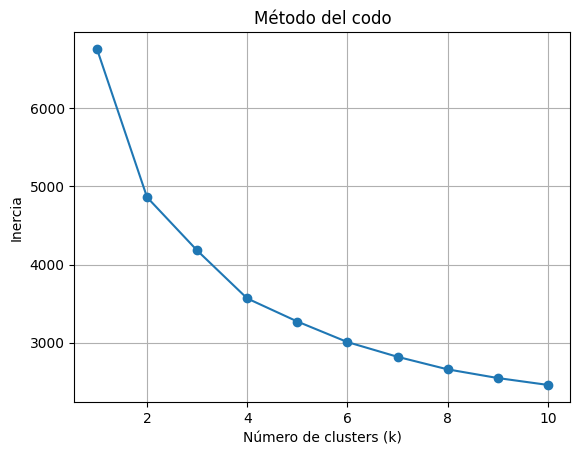

In [30]:
max_clusters = 10
elbow_method(df_processed, max_clusters)

##### Kmeans sin reducción de dimensionalidad

In [31]:
k = 4
clusters1, centroides1 = K_means(df_processed, k, 100, 0.0001)

# Valores únicos de los clusters (los números de los clusters)
print('Valores únicos de cada cluster sin PCA: ', clusters1.unique())

Valores únicos de cada cluster sin PCA:  [0 2 3 1]


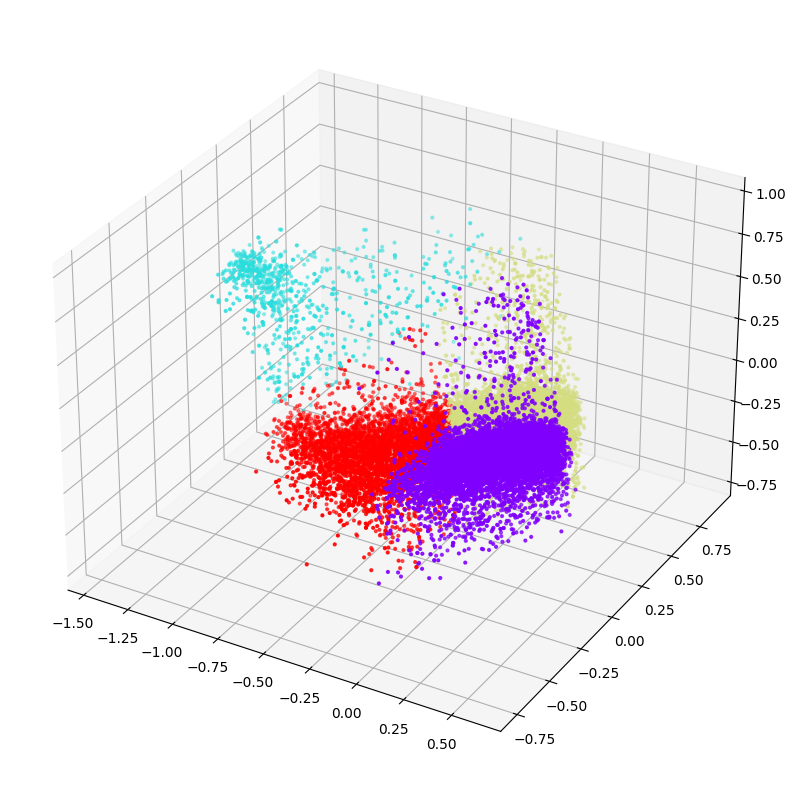

In [32]:
from mpl_toolkits.mplot3d import Axes3D

# Visualizar clusters
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df_processed_pca.iloc[:,0], df_processed_pca.iloc[:,1], df_processed_pca.iloc[:,2], c=clusters1, cmap='rainbow', s=4)
fig.set_size_inches(10, 10)
plt.show()

##### Kmeans con reducción de dimensionalidad

In [33]:
clusters2, centroides2 = K_means(df_processed_pca, k, 100, 0.0001)

# Valores únicos de los clusters (los números de los clusters)
print('Valores únicos de cada cluster con PCA: ', clusters2.unique())

Valores únicos de cada cluster con PCA:  [0 2 1 3]


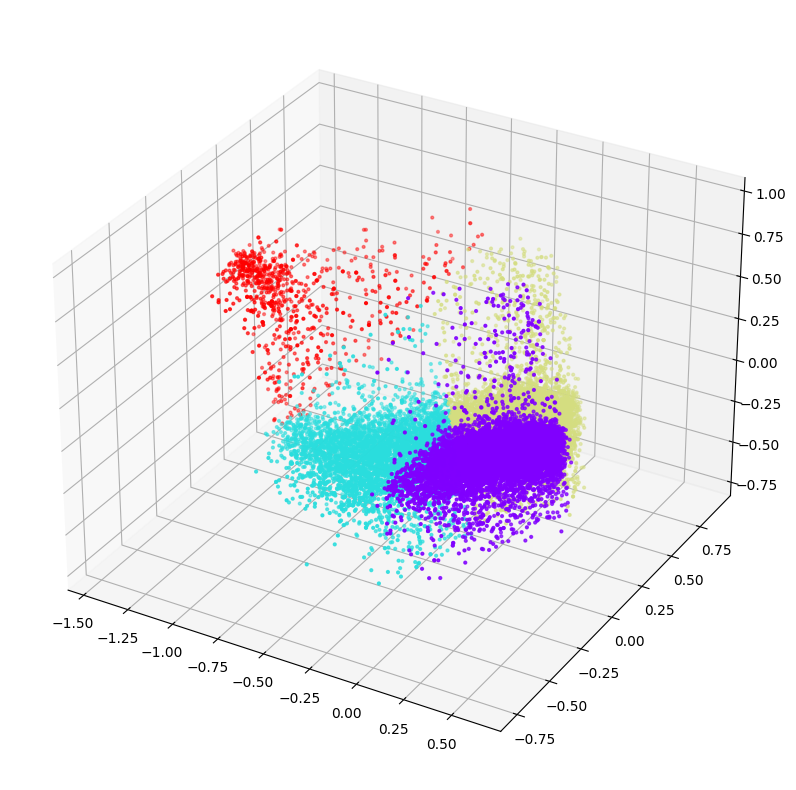

In [34]:
# Visualizar clusters
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df_processed_pca.iloc[:,0], df_processed_pca.iloc[:,1], df_processed_pca.iloc[:,2], c=clusters2, cmap='rainbow', s=4)
fig.set_size_inches(10, 10)
plt.show()


#### Clustering Agglomerative

Crear dendrograma

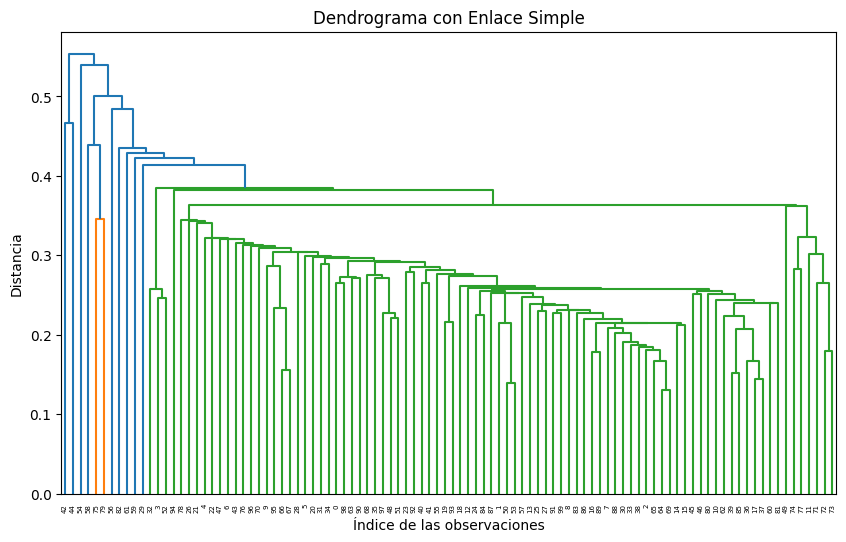

In [35]:
Dendrograma(df_processed[:100])

Clustering sin PCA

In [36]:
aglomerativo_com = Agglomerative(df_processed[:500], 4)

aglomerativo_com.agglomerative()
clusters1_agg = aglomerativo_com.clusters
clusters1_agg = cluster_dict_to_list(clusters1_agg)

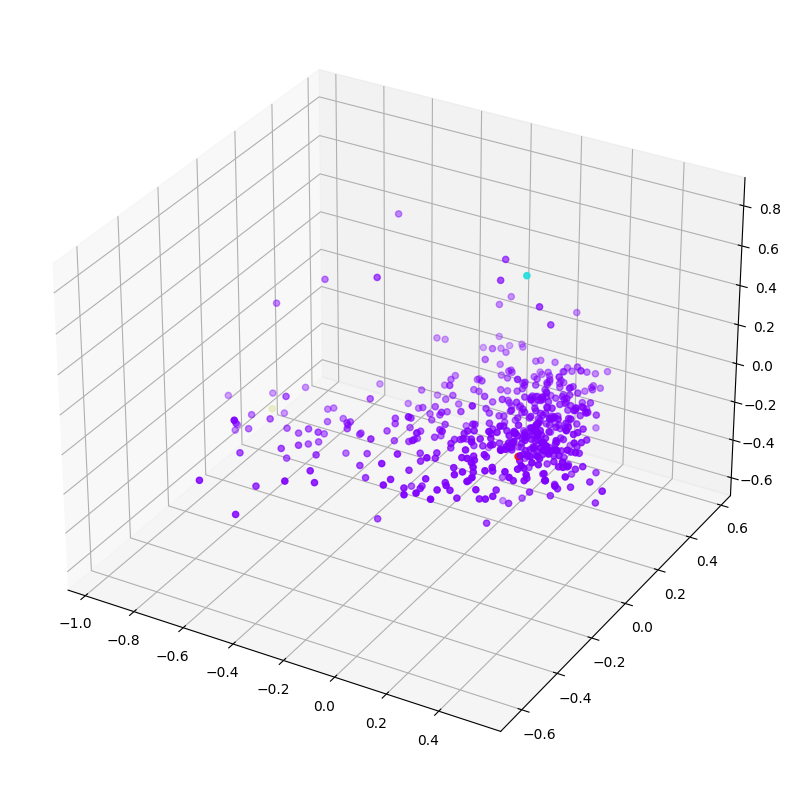

In [49]:
# Visualizar clusters
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df_processed_pca.iloc[:500,0], df_processed_pca.iloc[:500,1], df_processed_pca.iloc[:500,2], c=clusters1_agg, cmap='rainbow', s=20)
fig.set_size_inches(10, 10)
plt.show()

Clustering con PCA

In [38]:
# Crear objeto Agglomerative
aglomerativo_pca = Agglomerative(df_processed_pca[:500], 3)

aglomerativo_pca.agglomerative()
clusters2_agg = aglomerativo_pca.clusters
clusters2_agg = cluster_dict_to_list(clusters2_agg)


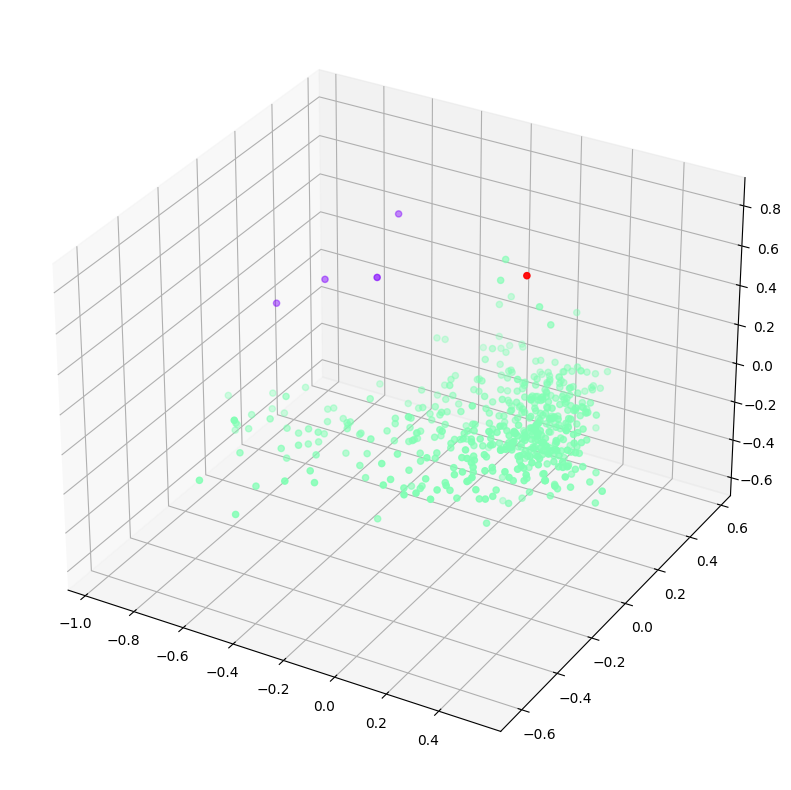

In [50]:
# Visualizar clusters
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df_processed_pca.iloc[:500,0], df_processed_pca.iloc[:500,1], df_processed_pca.iloc[:500,2], c=clusters2_agg, cmap='rainbow', s=20)
fig.set_size_inches(10, 10)
plt.show()

##### En esta sección se aplica Kmeans con la misma cantidad de datos que en Agglomerative, para poder realizar una comparación más directa, pues la función escrita posee una gran complejidad computacional

K-means sin PCA

In [40]:
clusters3, centroides3 = K_means(df_processed[:500], k, 100, 0.0001)

# Valores únicos de los clusters (los números de los clusters)
print('Valores únicos de cada cluster con PCA: ', clusters3.unique())

Valores únicos de cada cluster con PCA:  [0 2 3 1]


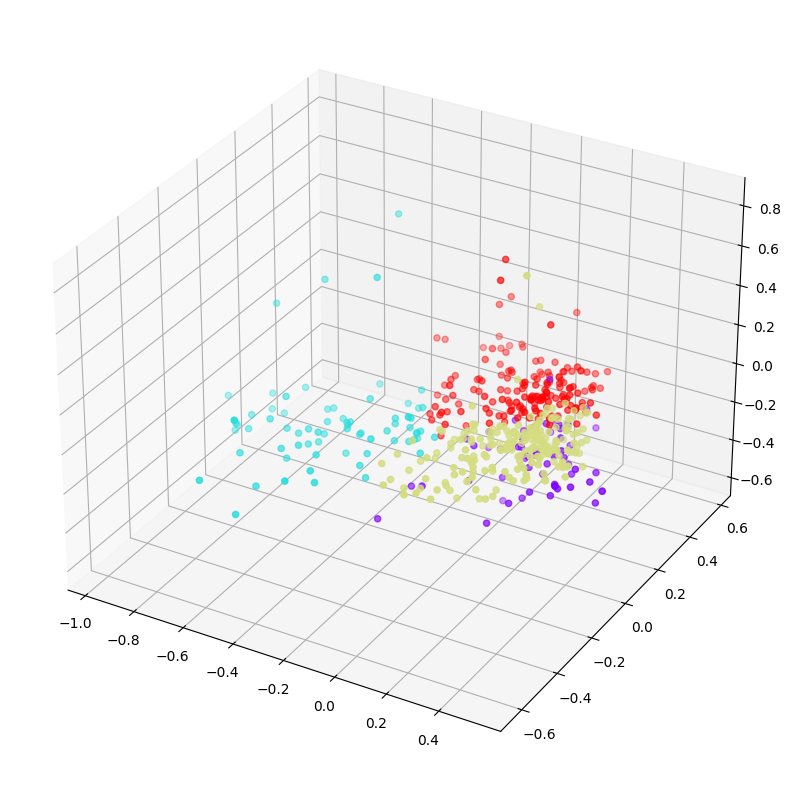

In [51]:
# Visualizar clusters
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df_processed_pca.iloc[:500,0], df_processed_pca.iloc[:500,1], df_processed_pca.iloc[:500,2], c=clusters3, cmap='rainbow', s=20)
fig.set_size_inches(10, 10)
plt.show()


K-means con PCA

In [43]:
clusters4, centroides4 = K_means(df_processed[:500], k, 100, 0.0001)

# Valores únicos de los clusters (los números de los clusters)
print('Valores únicos de cada cluster con PCA: ', clusters4.unique())

Valores únicos de cada cluster con PCA:  [1 2 0 3]


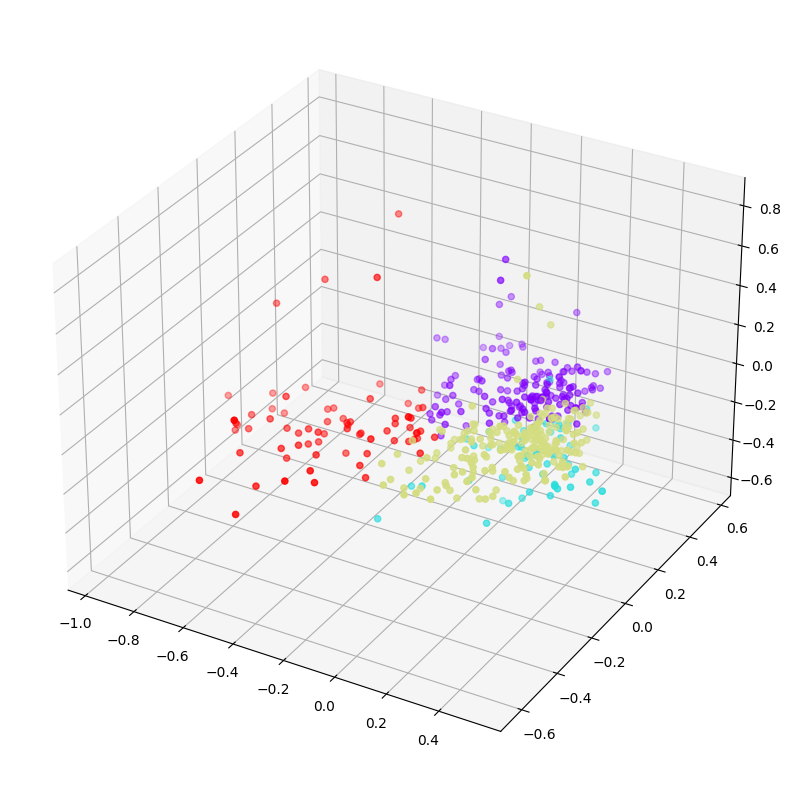

In [52]:
# Visualizar clusters
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df_processed_pca.iloc[:500,0], df_processed_pca.iloc[:500,1], df_processed_pca.iloc[:500,2], c=clusters4, cmap='rainbow', s=20)
fig.set_size_inches(10, 10)
plt.show()
